# Image Optimisation

This notebook explores what happens if you try to optimise a set of randomly positioned points or lines to fit a greyscale image. The lines/points are rasterised as near black & white. Because of this, we explore a few different loss measures to the normal MSE, that allow the optimiser to capture more perceptual features in the resultant rasters (for example, capturing that lines drawn closely together will perceptually look more like a shade of grey).

The following code block loads an image, converts it to greyscale and displays it:

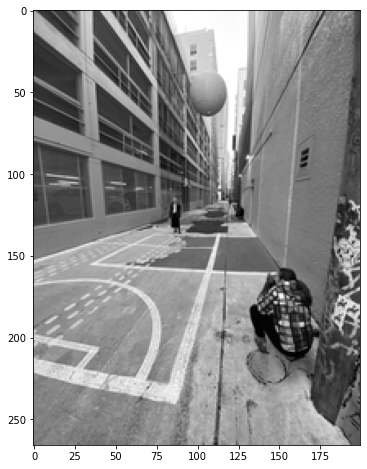

In [1]:
import torch
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO
import numpy as np

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

response = requests.get("https://artist-cloud.ecs.soton.ac.uk/s/8u24DnIvVoMIM0x/download")
img = Image.open(BytesIO(response.content))

basewidth = 200
wpercent = (basewidth/float(img.size[0]))
hsize = int((float(img.size[1])*float(wpercent)))
img = img.resize((basewidth,hsize), Image.ANTIALIAS)

img = np.array(img.convert("L"), dtype=np.float32) / 255.

img = torch.from_numpy(img).to(device)

plt.figure(figsize=(8,8))
plt.imshow(img.cpu(), cmap='gray')

This code block defines an optimisation function which performs gradient descent on a loss function (by default a asymmetric gaussian-blurred MSE) to more the points/line parameters to produce a "better" raster. The optimiser anneals the sigma of the underlying rasteriser over iterations to help convergence. The function produces a 10-frame animation of the optimisation so we can see visualise what is happening.

We also define a coordinate grid that matches the pixel coordinates of the image (this does impact the required learning rate of the optimiser - hence why it is relatively huge!):

In [2]:
try: 
    from celluloid import Camera
except:
    !pip install celluloid
    from celluloid import Camera

from tqdm.notebook import tqdm    
    
import torch
import matplotlib.pyplot as plt
from torch.nn.functional import mse_loss
from dsketch.raster.disttrans import point_edt2, line_edt2, curve_edt2_bruteforce
from dsketch.raster.raster import exp
from dsketch.raster.composite import softor
from dsketch.losses import BlurredMSE
from IPython.display import HTML
from dsketch.utils.pyxdrawing import draw_points, draw_line_segments

def optimise(target, params, render_fn, lr=200, steps=2000, sigma_init=30, sigma_min=10, sigma_factor=2, sigma_step=500, loss=None):
    fig = plt.figure(figsize=(16, 8))
    camera = Camera(fig)
    sp1 = fig.add_subplot(1, 2, 1)
    sp1.set_title("Target")
    sp2 = fig.add_subplot(1, 2, 2)
    sp2.set_title("Estimate")
    
    params.requires_grad = True
    sigma = sigma_init
    
    if loss is None:
        loss = BlurredMSE(1, 1.).to(params.device)
    
    snapshot = int(steps/10)
    
    for i in tqdm(range(steps)):
        params.grad = None
        est = render_fn(params, sigma)
        l = loss(est.view(1, 1, *est.shape), target.view(1, 1, *target.shape))
        l.backward()
        params.data = params - params.grad * lr
        
        if i % snapshot == 0:
            sp1.imshow(target.cpu(), cmap='gray')
            sp2.imshow(est.detach().cpu(), cmap='gray')
            camera.snap()

        if i % sigma_step == 0:
            if sigma>sigma_min:
                sigma = sigma / sigma_factor
                sigma = max(sigma, sigma_min)
    
    
    # create the animation
    anim = camera.animate()
    plt.close()

    return params, anim

r = torch.linspace(0, img.shape[0] - 1, img.shape[0])
c = torch.linspace(0, img.shape[1] - 1, img.shape[1])
grid = torch.meshgrid(r, c)
grid = torch.stack(grid, dim=2).to(device)

## Optimising points

Here we optimise 2000 points to fit the image. The points are drawn in white, and the background is black; the resultant image captures light and dark parts of the image well and the structure is evident.

In [3]:
def render_points(params, sigma):
    return softor(exp(point_edt2(params, grid), sigma).unsqueeze(0)).squeeze(0)

params = torch.rand((2000,2), device=device)
params[:,0] *= img.shape[0]
params[:,1] *= img.shape[1]
params, anim = optimise(img, params, render_points, lr=200, sigma_init=60, sigma_min=1, steps=4000)

HTML(anim.to_jshtml())

We can also do the same process, but with the target inverted so that we draw 'dark' bits of the image rather than white ones:

In [4]:
params = torch.rand((2000,2), device=device)
params[:,0] *= img.shape[0]
params[:,1] *= img.shape[1]
params, anim = optimise(1-img, params, render_points, lr=200, sigma_init=60, sigma_min=1, steps=4000)

draw_points(params, "points.pdf")
HTML(anim.to_jshtml())

## Line Optimisation

The following cells all explore different ways of line drawing.

### Long initial lines

This code block optimises 100 lines, which are initialised to be quite long. The lines are drawn as white on a black background and are hence attracted to light areas in the image. The result is quite abstract!

In [5]:
def render_lines(params, sigma):
    return softor(exp(line_edt2(params, grid), sigma).unsqueeze(0)).squeeze(0)

params = torch.rand((100,2,2), device=device)
params[:,0,0] *= img.shape[0]
params[:,0,1] *= img.shape[1]
params[:,1,0] *= img.shape[0]
params[:,1,1] *= img.shape[1]
params, anim = optimise(img, params, render_lines, lr=200, sigma_init=60, sigma_min=1, steps=8000)

HTML(anim.to_jshtml())

### Shorter lines, inverted image

This time 1000 initially short lines are optimised. As before the lines are drawn as white on black, but the target image is inverted, encouraging the lines to be attracted to filling dark areas in the original image:

In [6]:
params = torch.rand((1000,2,2), device=device)
params[:,0,0] *= img.shape[0]
params[:,0,1] *= img.shape[1]
params[:,1,0] = params[:,0,0] + 10*params[:,1,0]
params[:,1,1] = params[:,0,1] + 10*params[:,1,1]
params, anim = optimise(1-img, params, render_lines, lr=200, sigma_init=10, sigma_min=0.5, steps=8000)

draw_line_segments(params, "shortlines.pdf", 1.0)
HTML(anim.to_jshtml())

We then take the final resultant image and draw it inverted with dark lines on a white background. This clearly is capturing much of the image structure:

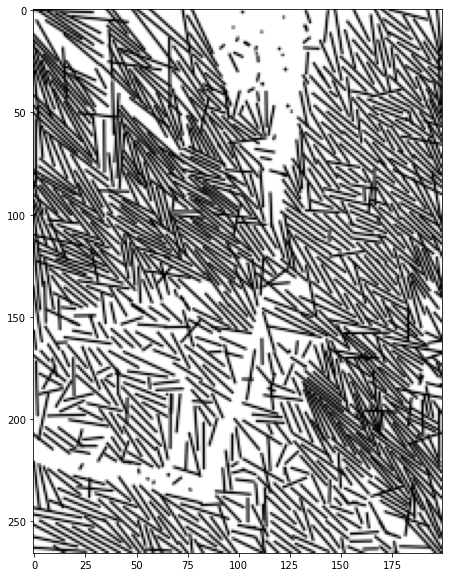

In [7]:
out = 1 - render_lines(params, 0.5)
plt.figure(figsize=(10,10))
plt.imshow(out.detach().cpu(), cmap='gray')

### Blurred MSE Loss - effect of amount of blurring

Now we explore the effect of the blurred-MSE loss and compare it against regular MSE (blur sigma=0). Each of the four images starts from exactly the same initial set of random lines. The sigma=1 variant is particularly striking because the lines are being encouraged to form parallel patterns to capture local greylevel intensities:

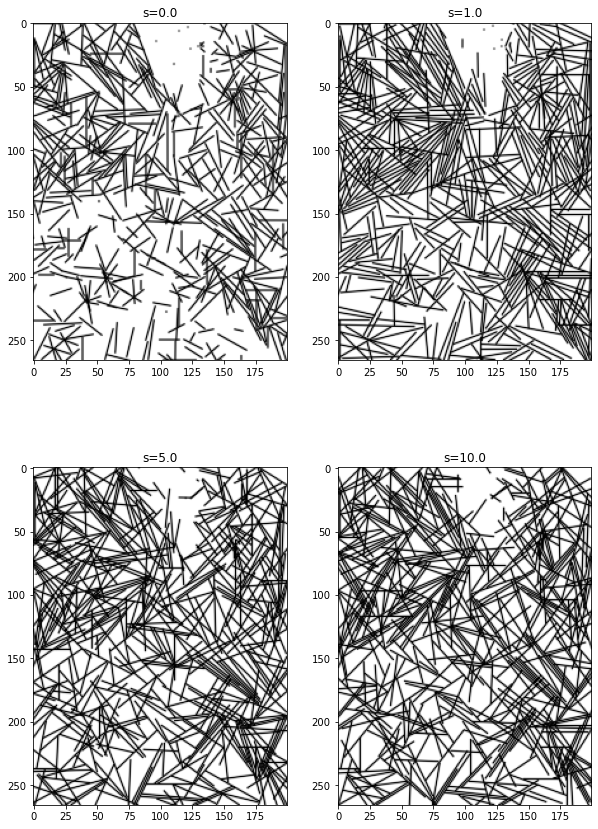

In [8]:
initparams = torch.rand((500,2,2), device=device)
initparams[:,0,0] *= img.shape[0]
initparams[:,0,1] *= img.shape[1]
initparams[:,1,0] = initparams[:,0,0] + 50*(initparams[:,1,0]-0.5)
initparams[:,1,1] = initparams[:,0,1] + 50*(initparams[:,1,1]-0.5)

draw_line_segments(initparams, "500lines_init.pdf")

fig, axs = plt.subplots(2, 2, figsize=(10,15))
scl = [0., 1., 5., 10.]
idx = [(0,0),(0,1),(1,0),(1,1)]
for s, i in zip(scl, idx): 
    l = BlurredMSE(1, s).to(device)
    p, _ = optimise(1-img, initparams.detach().clone(), render_lines, lr=400, sigma_init=10, sigma_min=0.3, steps=8000, loss=l)
    draw_line_segments(p, "500lines_s="+str(s)+".pdf", 1)
    out = 1 - render_lines(p, 0.5)
    axs[i].set_title("s="+str(s))
    axs[i].imshow(out.detach().cpu(), cmap='gray')

### Pyramid MSE Loss

The following shows the effect of the PyramidMSE loss compared to BlurredMSE:

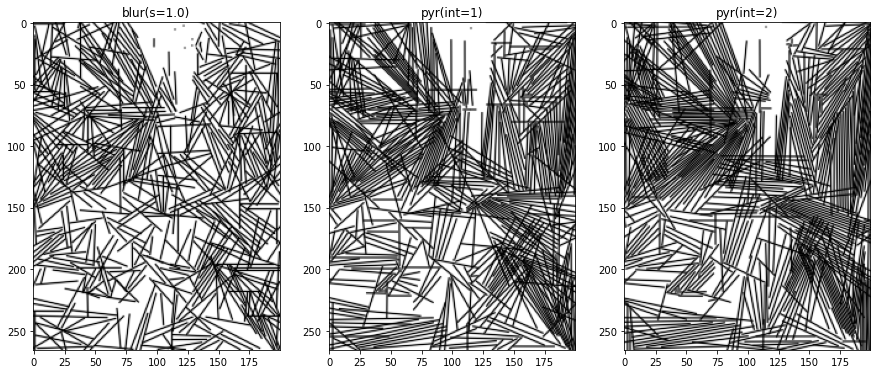

In [9]:
from dsketch.losses import PyramidMSE

fig, axs = plt.subplots(1, 3, figsize=(15,10))

l = BlurredMSE(1, 1.0).to(device)
p, _ = optimise(1-img, initparams.detach().clone(), render_lines, lr=400, sigma_init=10, sigma_min=0.3, steps=8000, loss=l)
out = 1 - render_lines(p, 0.5)
axs[0].set_title("blur(s="+str(1.0)+")")
axs[0].imshow(out.detach().cpu(), cmap='gray')


scl = [1, 2]
idx = [1, 2]
for s, i in zip(scl, idx): 
    l = PyramidMSE(1, octaves=5, intervals=s).to(device)    
    p, _ = optimise(1-img, initparams.detach().clone(), render_lines, lr=400, sigma_init=10, sigma_min=0.3, steps=8000, loss=l)
    out = 1 - render_lines(p, 0.5)
    draw_line_segments(p, "500lines_pyr_int="+str(s)+".pdf")
    axs[i].set_title("pyr(int="+str(s)+")")
    axs[i].imshow(out.detach().cpu(), cmap='gray')

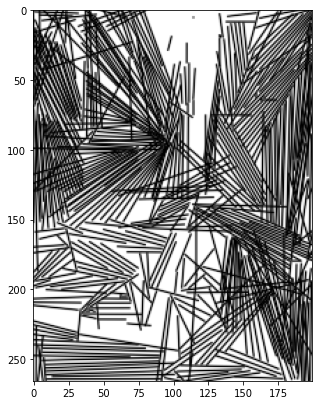

In [10]:
plt.figure(figsize=(5,10))
l = PyramidMSE(1, octaves=5, intervals=4).to(device)    
p, _ = optimise(1-img, initparams.detach().clone(), render_lines, lr=400, sigma_init=10, sigma_min=0.3, steps=8000, loss=l)
draw_line_segments(p, "500lines_pyr_int=4.pdf")
out = 1 - render_lines(p, 0.5)
plt.imshow(out.detach().cpu(), cmap='gray')

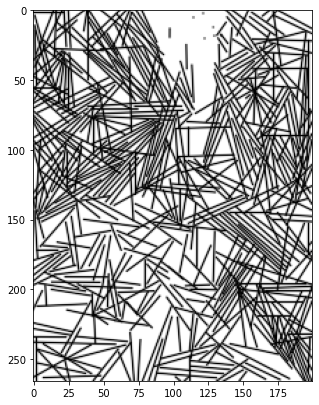

In [11]:
plt.figure(figsize=(5,10))
l = BlurredMSE(1, 1.0, symmetric=True).to(device)
p, _ = optimise(1-img, initparams.detach().clone(), render_lines, lr=400, sigma_init=10, sigma_min=0.3, steps=8000, loss=l)
draw_line_segments(p, "500lines_s=1_sym.pdf")
out = 1 - render_lines(p, 0.5)
plt.imshow(out.detach().cpu(), cmap='gray')

In [12]:
print(img.shape)

torch.Size([266, 200])
